In [1]:
# ============================================================
# FULL JAKARTA WORKFLOW
# ENU PKL → velocities → uncertainties → kriging → plotting
# ============================================================

import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from pykrige.ok import OrdinaryKriging
import contextily as cx
from matplotlib.ticker import FuncFormatter


In [2]:
with open("jakarta_enu_estimates.pkl", "rb") as f:
    data = pickle.load(f)

x_rum = data['x_rum'].values
y_rum = data['y_rum'].values

east_est  = data['east'].values        # meters / yr
north_est = data['north'].values       # meters / yr
up_est    = data['up'].values          # mm / yr (already corrected)

var_east  = data['var_east'].values
var_north = data['var_north'].values
covar_en  = data['covar_en'].values

print("✅ Loaded jakarta_enu_estimates.pkl")


✅ Loaded jakarta_enu_estimates.pkl


In [3]:
nr_rums = len(x_rum)

# Vertical velocity (mm/yr)
normal_vel = up_est.copy()

# Scaling for horizontal components
scaling = 1000.0  # meters → mm


In [4]:
random_idx = np.random.permutation(nr_rums)

# Number of vectors to plot (use all; subsample if desired)
nr_vectors_plot = nr_rums


In [5]:
transversal_vel = np.zeros(nr_vectors_plot)
std_transversal = np.zeros(nr_vectors_plot)
longitudinal_angle_rum_rad = np.zeros(nr_vectors_plot)

for k in range(nr_vectors_plot):

    idx = random_idx[k]

    # -----------------------------------
    # EN components (meters → mm)
    # -----------------------------------
    east_rum  = east_est[idx]  * scaling
    north_rum = north_est[idx] * scaling

    # Vector magnitude (mm/yr)
    trans_displ_rum = np.sqrt(east_rum**2 + north_rum**2)
    transversal_vel[k] = trans_displ_rum

    # Direction relative to North (CCW)
    longitudinal_angle_rum_rad[k] = np.arctan2(east_rum, north_rum)

    if trans_displ_rum == 0:
        std_transversal[k] = np.nan
        continue

    # -----------------------------------
    # EN variance–covariance matrix (mm²)
    # -----------------------------------
    Q_en = np.array([
        [var_east[idx]  * scaling**2, covar_en[idx] * scaling**2],
        [covar_en[idx] * scaling**2,  var_north[idx] * scaling**2]
    ])

    # Unit vector along motion direction
    u = np.array([
        east_rum  / trans_displ_rum,
        north_rum / trans_displ_rum
    ])

    # Std of transversal velocity (mm/yr)
    std_transversal[k] = np.sqrt(u.T @ Q_en @ u)


In [6]:
x_rum_plot = x_rum[random_idx][:nr_vectors_plot]
y_rum_plot = y_rum[random_idx][:nr_vectors_plot]
normal_vel_plot = normal_vel[random_idx][:nr_vectors_plot]


In [7]:
grid_with_kriging = 500  # meters

xCoords = np.arange(
    np.min(x_rum) - 1000,
    np.max(x_rum) + 1000 + grid_with_kriging,
    grid_with_kriging
)

yCoords = np.arange(
    np.min(y_rum) - 1000,
    np.max(y_rum) + 1000 + grid_with_kriging,
    grid_with_kriging
)

X, Y = np.meshgrid(xCoords, yCoords)


Plotting Enabled

Adjusting data for anisotropy...
Initializing variogram model...
Coordinates type: 'euclidean' 

Using 'gaussian' Variogram Model
Partial Sill: 36
Full Sill: 42
Range: 7500
Nugget: 6 



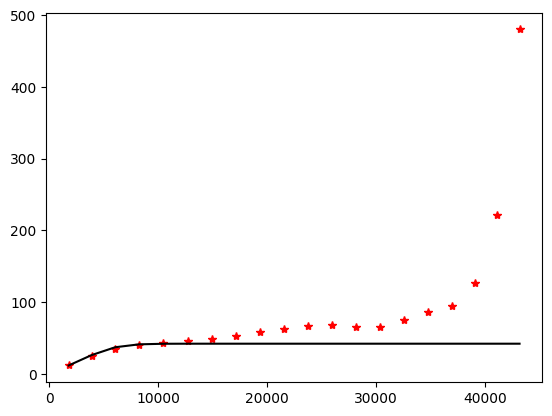

Calculating statistics on variogram model fit...
Executing Ordinary Kriging...

✅ mean_kriging constructed


In [8]:
range_contour  = 7500
sill_contour   = 42
nugget_contour = 6

OK_contour = OrdinaryKriging(
    x_rum,
    y_rum,
    normal_vel,  # mm/yr
    variogram_model='gaussian',
    variogram_parameters=[sill_contour, range_contour, nugget_contour],
    verbose=True,
    enable_plotting=True,
    nlags=20
)

mean_kriging, ss = OK_contour.execute('grid', xCoords, yCoords)

print("✅ mean_kriging constructed")


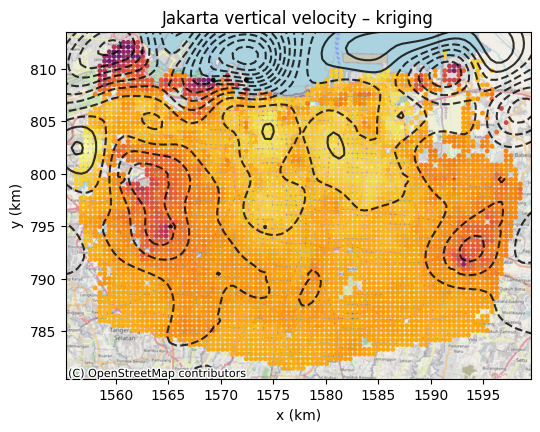

In [9]:
formatter = FuncFormatter(lambda x, pos: f"{x/1000:.0f}")

fig, ax = plt.subplots(figsize=(6, 5.6))

plt.contour(
    X, Y, mean_kriging,
    levels=13,
    colors='black',
    alpha=0.8
)

plt.scatter(x_rum, y_rum, c=normal_vel, s=6, cmap='inferno')

ax.set_xlim(np.min(x_rum)-1000, np.max(x_rum)+1000)
ax.set_ylim(np.min(y_rum)-1000, np.max(y_rum)+1000)
ax.set_aspect('equal')

ax.xaxis.set_major_formatter(formatter)
ax.yaxis.set_major_formatter(formatter)

ax.set_xlabel("x (km)")
ax.set_ylabel("y (km)")
ax.set_title("Jakarta vertical velocity – kriging")

cx.add_basemap(
    ax,
    crs='epsg:23830',
    source=cx.providers.OpenStreetMap.Mapnik,
    zoom=12
)

plt.show()


In [14]:
def plot_jakarta_subsidence(
    x_rum, y_rum,
    normal_est_combined,
    transversal_est_combined,
    std_transversal_est_combined,
    longitudinal_angle_rum_rad,
    mean_kriging, corr_gnss_pov,
    X, Y,
    from_transversal_to_north_east,
    formatter,
    std_beta,
    regions_proj,
    start_date="2014-10-12",
    end_date="2025-06-04",
    scaling=320,
    plot_streetmap=True
):
    import numpy as np
    import pandas as pd
    import math
    import matplotlib
    import matplotlib.pyplot as plt
    import matplotlib.patheffects as path_effects
    from matplotlib.colors import LinearSegmentedColormap
    from matplotlib.patches import Ellipse, Rectangle
    from mpl_toolkits.axes_grid1.inset_locator import inset_axes, mark_inset
    import contextily as cx
    from shapely.geometry import MultiPoint, Polygon, box
    from pyproj import Transformer

    # --------------------------------------------------
    # --- Custom colormap (hot_not_black_r)
    # --------------------------------------------------
    colors = [
        (0.0, "darkred"),
        (0.175, "red"),
        (0.35, "orange"),
        (0.50, "yellow"),
        (0.75, "white"),
        (1.0, "white"),
    ]
    cmap = LinearSegmentedColormap.from_list("hot_not_black_r", colors)
    matplotlib.colormaps.register(cmap=cmap, name="hot_not_black_r", force=True)

    # --------------------------------------------------
    # --- Velocities
    # --------------------------------------------------
    normal_vel = normal_est_combined + corr_gnss_pov
    mean_norm = np.nanmean(normal_vel)
    std_norm = np.nanstd(normal_vel)

    vmin = -40
    vmax = 0

    contour_levels = np.arange(
        np.floor(np.nanmin(mean_kriging + corr_gnss_pov) / 5) * 5,
        np.ceil(np.nanmax(mean_kriging + corr_gnss_pov) / 5) * 5 + 5,
        5,
    )

    # --------------------------------------------------
    # --- Figure
    # --------------------------------------------------
    x_rng = np.ptp(x_rum)
    y_rng = np.ptp(y_rum)
    fig, ax = plt.subplots(
        figsize=(12, 12 * y_rng / x_rng),
        dpi=500
    )

    sc = ax.scatter(
        x_rum, y_rum,
        c=normal_vel,
        s=37.7,
        alpha=0.75,
        cmap="hot_not_black_r",
        vmin=vmin, vmax=vmax,
        marker="s",
        linewidths=0
    )

    contour = ax.contour(
        X, Y, mean_kriging + corr_gnss_pov,
        levels=contour_levels,
        colors="white",
        linestyles="dashed",
        linewidths=0.65,
        alpha=0.5
    )
    ax.clabel(contour, inline=True, fontsize=8, fmt="%.1f")

    # --------------------------------------------------
    # --- Transversal vectors
    # --------------------------------------------------
    mm_to_plot = scaling
    head_len = 0.3 * np.nanmean(np.abs(transversal_est_combined) * mm_to_plot)
    head_wid = head_len
    wdt = 0.1 * np.nanmean(np.abs(transversal_est_combined) * mm_to_plot)

    ellipse_color = "#CCFF00"

    for i in range(len(x_rum)):
        trans = transversal_est_combined[i]
        std_t = std_transversal_est_combined[i]
        ang = longitudinal_angle_rum_rad[i]

        plot_val = trans * mm_to_plot
        e_v = mm_to_plot * 2 * std_t
        e_h = mm_to_plot * np.tan(std_beta) * 2 * std_t

        if np.isnan(e_v) or plot_val <= e_v / 2 or plot_val <= 0:
            continue

        dx, dy = from_transversal_to_north_east(1.0, ang)
        dx *= plot_val
        dy *= plot_val

        ax.add_patch(Ellipse(
            (x_rum[i] + dx, y_rum[i] + dy),
            e_h, e_v,
            angle=-np.rad2deg(ang) - 90,
            ec=ellipse_color, fc="none", alpha=0.65, linewidth=0.55
        ))

        ax.arrow(x_rum[i], y_rum[i], dx, dy,
                 width=wdt*2.1,
                 head_length=head_len*1.3,
                 head_width=head_wid*1.3,
                 color=ellipse_color,
                 alpha=0.8)

        ax.arrow(x_rum[i], y_rum[i], dx, dy,
                 width=wdt,
                 head_length=head_len,
                 head_width=head_wid,
                 color="black",
                 alpha=0.8)

    # --------------------------------------------------
    # --- CJKT station
    # --------------------------------------------------
    transformer = Transformer.from_crs("EPSG:4326", "EPSG:23830", always_xy=True)
    cjkt_x, cjkt_y = transformer.transform(106.884529, -6.110110)

    ax.scatter(cjkt_x, cjkt_y, s=150, marker="^",
               facecolor="#C186F5", edgecolor="black", zorder=11)

    ax.text(
        cjkt_x, cjkt_y + 800, "CJKT",
        fontsize=10, fontweight="bold", ha="center",
        path_effects=[
            path_effects.Stroke(linewidth=2, foreground="white"),
            path_effects.Normal()
        ]
    )

    # --------------------------------------------------
    # --- Subsidence bowls & statistics
    # --------------------------------------------------
    start = pd.to_datetime(start_date)
    end = pd.to_datetime(end_date)
    years = (end - start).days / 365.25

    summary = []
    roman = ["I", "II", "III", "IV", "V", "VI"]
    turquoise = "#40E0D0"

    xr = np.asarray(x_rum)
    yr = np.asarray(y_rum)

    for i, (x1, y1, x2, y2) in enumerate(regions_proj):
        xmin, xmax = sorted([x1, x2])
        ymin, ymax = sorted([y1, y2])

        inside = (xr >= xmin) & (xr <= xmax) & (yr >= ymin) & (yr <= ymax)
        idx = np.where(inside)[0]

        if idx.size > 0:
            mean_n = np.nanmean(normal_vel[idx])
            min_n = np.nanmin(normal_vel[idx])
            mean_t = np.nanmean(transversal_est_combined[idx])
            max_t = np.nanmax(transversal_est_combined[idx])
        else:
            mean_n = min_n = mean_t = max_t = np.nan

        summary.append(dict(
            region=f"Region_{roman[i]}",
            n_points=idx.size,
            mean_normal_mm_yr=mean_n,
            min_normal_mm_yr=min_n,
            mean_transversal_mm_yr=mean_t,
            max_transversal_mm_yr=max_t,
            mean_normal_cum_mm=mean_n * years,
            min_normal_cum_mm=min_n * years,
            mean_transversal_cum_mm=mean_t * years,
            max_transversal_cum_mm=max_t * years
        ))

        rect = box(xmin, ymin, xmax, ymax)
        rx, ry = rect.exterior.xy
        ax.plot(rx, ry, linestyle=":", color=turquoise, linewidth=1.2)

        ax.text(
            xmin, ymax, roman[i],
            color=turquoise, fontsize=12, fontweight="bold",
            path_effects=[
                path_effects.Stroke(linewidth=1.5, foreground="black"),
                path_effects.Normal()
            ]
        )

    # --------------------------------------------------
    # --- Basemap
    # --------------------------------------------------
    if plot_streetmap:
        cx.add_basemap(ax, crs="EPSG:23830",
                       source=cx.providers.OpenStreetMap.Mapnik,
                       zoom=12, attribution=False)

    ax.set_aspect("equal")
    ax.set_xticks([])
    ax.set_yticks([])

    # --------------------------------------------------
    # --- Colorbar
    # --------------------------------------------------
    cax = inset_axes(ax, width="27%", height="1.5%", loc="upper right")
    cbar = plt.colorbar(sc, cax=cax, orientation="horizontal")
    cbar.set_label("Vertical displacement velocity [mm/yr]")
    cbar.ax.xaxis.set_label_position("top")

    plt.show()

    return pd.DataFrame(summary)

def from_transversal_to_north_east(transversal, angle):
    if angle >=0 and angle < (1/2) * np.pi:
        dy = transversal * -1 * np.sin(angle)
        dx = transversal * np.cos(angle)

    elif angle >=(1/2) * np.pi and angle < np.pi:
        dy = transversal * -1 * np.cos(angle - (1/2) * np.pi)
        dx = transversal * -1 * np.sin(angle - (1/2) * np.pi)

    elif angle >=(1) * np.pi and angle < (3/2) * np.pi:
        dy = transversal * np.sin(angle - np.pi)
        dx = transversal * -1 * np.cos(angle - np.pi)

    elif angle >=(3/2) * np.pi and angle < (2) * np.pi:
        dy = transversal * np.cos(angle - (3/2) * np.pi)
        dx = transversal * np.sin(angle - (3/2) * np.pi)
    
    else:
        raise ValueError(f"angle_rum must be between 0 and 2π, now it is {angle_rum}")  # Optioneel, voor foutafhandel
    
    return dx, dy


Plotting Enabled

Adjusting data for anisotropy...
Initializing variogram model...
Coordinates type: 'euclidean' 

Using 'gaussian' Variogram Model
Partial Sill: 36
Full Sill: 42
Range: 7500
Nugget: 6 



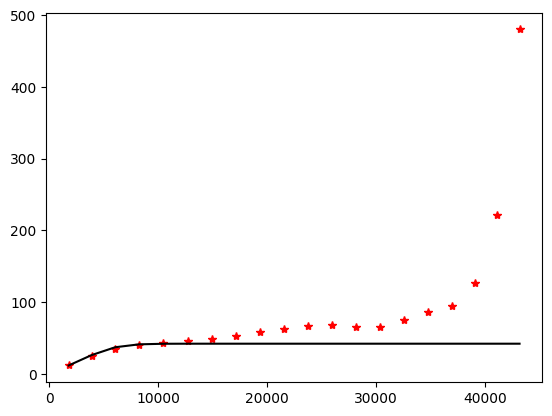

Calculating statistics on variogram model fit...


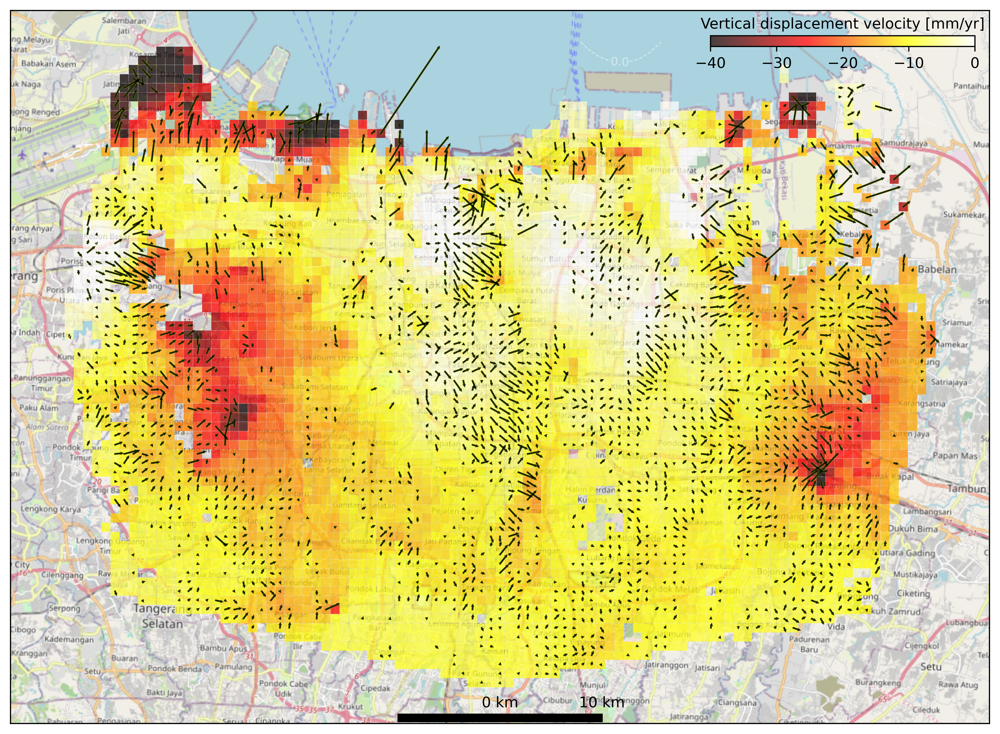

In [19]:
# --- Jakarta GNSS Displacement Plot with EPSG:23830 and styling like your example ---

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Ellipse, Rectangle
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, mark_inset
import contextily as cx
from shapely.geometry import MultiPoint, Polygon, box
from pykrige.ok import OrdinaryKriging
from pyproj import Transformer
import math
import matplotlib.ticker as mticker
import matplotlib.patheffects as path_effects

# --- Formatter for km labels ---
def meters_to_km_labels(x, pos):
    return f"{int(x // 1000)}"

formatter = mticker.FuncFormatter(meters_to_km_labels)

# --- Load Jakarta ENU data ---
data_path = 'jakarta_enu_estimates.pkl'
df = pd.read_pickle(data_path)

x_rum = df['x_rum'].values
y_rum = df['y_rum'].values
east_est = df['east'].values
north_est = df['north'].values
up_est = df['up'].values
var_east = df['var_east'].values
var_north = df['var_north'].values
covar_en = df['covar_en'].values

# --- Settings ---
scaling = 320                 # mm/yr → plot units
plot_streetmap = True
nr_vectors_plot = len(x_rum)
n_std_plot = 2                # Error ellipse multiplier

# --- Kriging for contour map ---
grid_spacing = 500
xCoords = np.arange(np.min(x_rum), np.max(x_rum) + grid_spacing, grid_spacing)
yCoords = np.arange(np.min(y_rum), np.max(y_rum) + grid_spacing, grid_spacing)
X, Y = np.meshgrid(xCoords, yCoords)

# range_contour = 18000
# sill_contour = 2.25e-6
# nugget_contour = (0.33e-3)**2



range_contour  = 7500
sill_contour   = 42
nugget_contour = 6

OK_contour = OrdinaryKriging(
    x_rum,
    y_rum,
    normal_vel,  # mm/yr
    variogram_model='gaussian',
    variogram_parameters=[sill_contour, range_contour, nugget_contour],
    verbose=True,
    enable_plotting=True,
    nlags=20
)


# OK_up = OrdinaryKriging(
#     x_rum, y_rum, up_est/1000,
#     variogram_model='gaussian',
#     variogram_parameters=[sill_contour, range_contour, nugget_contour],
#     verbose=False,
#     enable_plotting=False
# )

interp_contour_up, ss1 = OK_up.execute('grid', xCoords, yCoords)

# --- Figure setup ---
x_range = np.max(x_rum) - np.min(x_rum)
y_range = np.max(y_rum) - np.min(y_rum)
aspect_ratio = x_range / y_range
fig_width = 12
fig_height = fig_width / aspect_ratio
fig, ax = plt.subplots(figsize=(fig_width, fig_height), dpi=500)

# --- Scatter plot of vertical displacement ---
sc = ax.scatter(
    x_rum, y_rum,
    c=up_est,
    s=37.7,
    alpha=0.75,
    cmap='hot',   # similar to 'hot_not_black_r'
    vmin=-40, vmax=0,
    marker='s', linewidths=0
)

# --- Plot vectors and error ellipses ---
head_len = 0.3 * np.mean(np.abs(east_est) * scaling)
head_wid = head_len
wdt = 0.1 * np.mean(np.abs(east_est) * scaling)

for k in range(nr_vectors_plot):
    x_coord = x_rum[k]
    y_coord = y_rum[k]
    dx = east_est[k] * scaling
    dy = north_est[k] * scaling

    # Skip non-positive horizontal displacement
    if dx <= 0:
        continue

    # Draw vector (double-stroke arrow)
    ax.arrow(x_coord, y_coord, dx, dy,
             length_includes_head=True, color='#CCFF00', alpha=0.65,
             width=wdt*2.1, head_length=head_len*1.3, head_width=head_wid*1.3, zorder=1)
    ax.arrow(x_coord, y_coord, dx, dy,
             length_includes_head=True, color='black', alpha=0.8,
             width=wdt, head_length=head_len, head_width=head_wid, zorder=2)

    # Error ellipse
    Q_en = np.array([
        [var_east[k]*scaling, covar_en[k]*scaling],
        [covar_en[k]*scaling, var_north[k]*scaling]
    ])
    eigenvals, eigenvecs = np.linalg.eigh(Q_en)
    order = eigenvals.argsort()[::-1]
    eigenvals, eigenvecs = eigenvals[order], eigenvecs[:, order]
    angle = np.degrees(np.arctan2(*eigenvecs[:,0][::-1]))
    width, height = n_std_plot * np.sqrt(eigenvals)
    ellip = Ellipse(
        (x_coord + dx, y_coord + dy),
        width=width, height=height, angle=angle,
        ec='#CCFF00', alpha=0.65, fc='none', linewidth=0.55
    )
    ax.add_patch(ellip)

# --- Contour ---
contour_levels = np.arange(np.floor(np.min(interp_contour_up)/5)*5,
                           np.ceil(np.max(interp_contour_up)/5)*5 + 5, 5)
contour = ax.contour(X, Y, interp_contour_up, levels=contour_levels,
                     colors='white', linestyles='dashed', alpha=0.5, linewidths=0.65)
ax.clabel(contour, inline=True, fontsize=8, fmt="%.1f", colors='white')

# --- Axis formatting ---
ax.set_xlim(np.min(x_rum) - 2000, np.max(x_rum) + 2000)
ax.set_ylim(np.min(y_rum) - 2000, np.max(y_rum) + 2000)
ax.set_aspect('equal', adjustable='datalim')
ax.set_xticks([])
ax.set_yticks([])
ax.set_xlabel('')
ax.set_ylabel('')

# --- Basemap ---
if plot_streetmap:
    cx.add_basemap(ax, crs='epsg:23830', source=cx.providers.OpenStreetMap.Mapnik, zoom=12, attribution=False)

# --- Scale bar (example 10 km) ---
scalebar_length_m = 10000
x_center = 0.5 * (ax.get_xlim()[0] + ax.get_xlim()[1])
y_min = ax.get_ylim()[0]
bar_height = (ax.get_ylim()[1] - ax.get_ylim()[0]) * 0.01
ax.add_patch(Rectangle((x_center-scalebar_length_m/2, y_min+100), scalebar_length_m, bar_height,
                       facecolor='black', edgecolor='black', zorder=5))
ax.text(x_center, y_min+300+bar_height, '0 km', fontsize=10, ha='center', va='bottom')
ax.text(x_center + scalebar_length_m/2, y_min+300+bar_height, '10 km', fontsize=10, ha='center', va='bottom')

# --- Colorbar ---
cax = inset_axes(ax, width="27%", height="1.5%", loc='upper right', bbox_to_anchor=(0, -0.015, 1, 1),
                 bbox_transform=ax.transAxes, borderpad=1)
cbar = plt.colorbar(sc, cax=cax, orientation='horizontal')
cbar.ax.xaxis.set_label_position('top')
cbar.set_label('Vertical displacement velocity [mm/yr]', labelpad=5)

plt.show()


In [22]:
# --- Jakarta GNSS Displacement Plot with EPSG:23830, styled like second example ---

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Ellipse, Rectangle
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, mark_inset
import contextily as cx
from shapely.geometry import MultiPoint, Polygon, box
from pykrige.ok import OrdinaryKriging
from pyproj import Transformer
import math
import matplotlib.ticker as mticker
import matplotlib.patheffects as path_effects
from matplotlib.colors import LinearSegmentedColormap
import matplotlib

matplotlib.colormaps.register(custom_cmap, name="hot_not_black_r")

# --- Formatter for km labels ---
def meters_to_km_labels(x, pos):
    return f"{int(x // 1000)}"
formatter = mticker.FuncFormatter(meters_to_km_labels)

# --- Load Jakarta ENU data ---
data_path = 'jakarta_enu_estimates.pkl'
df = pd.read_pickle(data_path)

x_rum = df['x_rum'].values
y_rum = df['y_rum'].values
east_est = df['east'].values
north_est = df['north'].values
up_est = df['up'].values
var_east = df['var_east'].values
var_north = df['var_north'].values
covar_en = df['covar_en'].values

# --- Settings ---
scaling = 320                 # mm/yr → plot units
plot_streetmap = True
n_std_plot = 2                # Error ellipse multiplier

# --- Custom colormap: hot_not_black_r ---
colors = [
    (0.0, "darkred"),
    (0.175, "red"),
    (0.35, "orange"),
    (0.50, "yellow"),
    (0.75, "white"),
    (1.0, "white")
]
custom_cmap = LinearSegmentedColormap.from_list("hot_not_black_r", colors)
matplotlib.colormaps.register(custom_cmap, name="hot_not_black_r")

# --- Kriging for contour map ---
grid_spacing = 500
xCoords = np.arange(np.min(x_rum), np.max(x_rum) + grid_spacing, grid_spacing)
yCoords = np.arange(np.min(y_rum), np.max(y_rum) + grid_spacing, grid_spacing)
X, Y = np.meshgrid(xCoords, yCoords)

# --- Ordinary Kriging (example: vertical displacement) ---
OK_up = OrdinaryKriging(
    x_rum, y_rum, up_est,
    variogram_model='gaussian',
    variogram_parameters=[42, 7500, 6],
    verbose=False,
    enable_plotting=False
)
interp_contour_up, ss1 = OK_up.execute('grid', xCoords, yCoords)

# --- Figure setup ---
x_range = np.max(x_rum) - np.min(x_rum)
y_range = np.max(y_rum) - np.min(y_rum)
aspect_ratio = x_range / y_range
fig_width = 12
fig_height = fig_width / aspect_ratio
fig, ax = plt.subplots(figsize=(fig_width, fig_height), dpi=500)

# --- Scatter plot of vertical displacement ---
vmin, vmax = -40, 0
sc = ax.scatter(
    x_rum, y_rum,
    c=up_est,
    s=37.7,
    alpha=0.75,
    cmap='hot_not_black_r',
    vmin=vmin, vmax=vmax,
    marker='s', linewidths=0
)

# --- Plot significant positive vectors & ellipses ---
head_len = 0.3 * np.mean(np.abs(east_est) * scaling)
head_wid = head_len
wdt = 0.1 * np.mean(np.abs(east_est) * scaling)

for k in range(len(x_rum)):
    dx = east_est[k] * scaling
    dy = north_est[k] * scaling

    # Only significant positive horizontal displacement
    if dx <= 0:
        continue

    x_coord = x_rum[k]
    y_coord = y_rum[k]

    # Draw double-stroke arrow
    ax.arrow(x_coord, y_coord, dx, dy,
             length_includes_head=True, color='#CCFF00', alpha=0.65,
             width=wdt*2.1, head_length=head_len*1.3, head_width=head_wid*1.3, zorder=1)
    ax.arrow(x_coord, y_coord, dx, dy,
             length_includes_head=True, color='black', alpha=0.8,
             width=wdt, head_length=head_len, head_width=head_wid, zorder=2)

    # Error ellipse
    Q_en = np.array([
        [var_east[k]*scaling, covar_en[k]*scaling],
        [covar_en[k]*scaling, var_north[k]*scaling]
    ])
    eigenvals, eigenvecs = np.linalg.eigh(Q_en)
    order = eigenvals.argsort()[::-1]
    eigenvals, eigenvecs = eigenvals[order], eigenvecs[:, order]
    angle = np.degrees(np.arctan2(*eigenvecs[:,0][::-1]))
    width, height = n_std_plot * np.sqrt(eigenvals)
    ellip = Ellipse(
        (x_coord + dx, y_coord + dy),
        width=width, height=height, angle=angle,
        ec='#CCFF00', alpha=0.65, fc='none', linewidth=0.55
    )
    ax.add_patch(ellip)

# --- Contours ---
contour_levels = np.arange(np.floor(np.min(interp_contour_up)/5)*5,
                           np.ceil(np.max(interp_contour_up)/5)*5 + 5, 5)
contour = ax.contour(X, Y, interp_contour_up, levels=contour_levels,
                     colors='white', linestyles='dashed', alpha=0.5, linewidths=0.65)
ax.clabel(contour, inline=True, fontsize=8, fmt="%.1f", colors='white')

# --- Axis formatting ---
ax.set_xlim(np.min(x_rum) - 2000, np.max(x_rum) + 2000)
ax.set_ylim(np.min(y_rum) - 2000, np.max(y_rum) + 2000)
ax.set_aspect('equal', adjustable='datalim')
ax.set_xticks([])
ax.set_yticks([])
ax.set_xlabel('')
ax.set_ylabel('')

# --- Basemap ---
if plot_streetmap:
    cx.add_basemap(ax, crs='epsg:23830', source=cx.providers.OpenStreetMap.Mapnik, zoom=12, attribution=False)

# --- Add 6 subsidence bowls (example coordinates) ---
regions_proj = [
    (1557000, 807500, 1564000, 813000),
    (1561000, 792000, 1567000, 802500),
    (1566000, 807500, 1571000, 811000),
    (1587000, 807500, 1591000, 810000),
    (1591000, 807500, 1594000, 812000),
    (1591000, 790000, 1598000, 801000)
]
turquoise = "#40E0D0"
xr = np.asarray(x_rum)
yr = np.asarray(y_rum)
norm = np.asarray(up_est)

for i, (x1, y1, x2, y2) in enumerate(regions_proj):
    xmin, xmax = min(x1, x2), max(x1, x2)
    ymin, ymax = min(y1, y2), max(y1, y2)
    inside = (xr >= xmin) & (xr <= xmax) & (yr >= ymin) & (yr <= ymax)
    idx = np.nonzero(inside)[0]

    if idx.size >= 3:
        pts = [(xr[j], yr[j]) for j in idx]
        hull = MultiPoint(pts).convex_hull
        if isinstance(hull, Polygon):
            hx, hy = hull.exterior.xy
            ax.plot(hx, hy, linestyle='-', linewidth=1.4, color=turquoise, zorder=10)
    elif idx.size == 2:
        ax.plot([xr[idx[0]], xr[idx[1]]], [yr[idx[0]], yr[idx[1]]],
                linestyle='-', linewidth=1.0, color=turquoise, zorder=10)
    elif idx.size == 1:
        ax.plot(xr[idx[0]], yr[idx[0]], marker='o', markersize=6, color=turquoise, zorder=11)

    # Dashed rectangle
    rect = box(xmin, ymin, xmax, ymax)
    rx, ry = rect.exterior.xy
    ax.plot(rx, ry, linestyle=':', linewidth=1.2, color=turquoise, zorder=9)

# --- Scale bar with white background ---
scalebar_length_m = 10000
x_center = 0.5 * (ax.get_xlim()[0] + ax.get_xlim()[1])
y_min = ax.get_ylim()[0]
bar_height = (ax.get_ylim()[1] - ax.get_ylim()[0]) * 0.01

# White background for scale
ax.add_patch(Rectangle(
    (x_center-scalebar_length_m/2 - 500, y_min + 50),
    scalebar_length_m + 1000, bar_height*3,
    facecolor='white', edgecolor='none', alpha=0.85, zorder=3
))

# Draw black scale bar
ax.add_patch(Rectangle(
    (x_center-scalebar_length_m/2, y_min+100), scalebar_length_m, bar_height,
    facecolor='black', edgecolor='black', zorder=4
))
ax.text(x_center, y_min+300+bar_height, '0 km', fontsize=10, ha='center', va='bottom', zorder=5)
ax.text(x_center + scalebar_length_m/2, y_min+300+bar_height, '10 km', fontsize=10, ha='center', va='bottom', zorder=5)

# --- Colorbar with white background ---
cax = inset_axes(ax, width="27%", height="1.5%", loc='upper right', bbox_to_anchor=(0, -0.015, 1, 1),
                 bbox_transform=ax.transAxes, borderpad=1)
# White background rectangle
ax.add_patch(Rectangle((0.70*ax.get_xlim()[0], ax.get_ylim()[1]+100), 1, 1, facecolor='white', zorder=10, alpha=0.85))
cbar = plt.colorbar(sc, cax=cax, orientation='horizontal')
cbar.ax.xaxis.set_label_position('top')
cbar.set_label('Vertical displacement velocity [mm/yr]', labelpad=5)

plt.show()


ValueError: A colormap named "hot_not_black_r" is already registered.

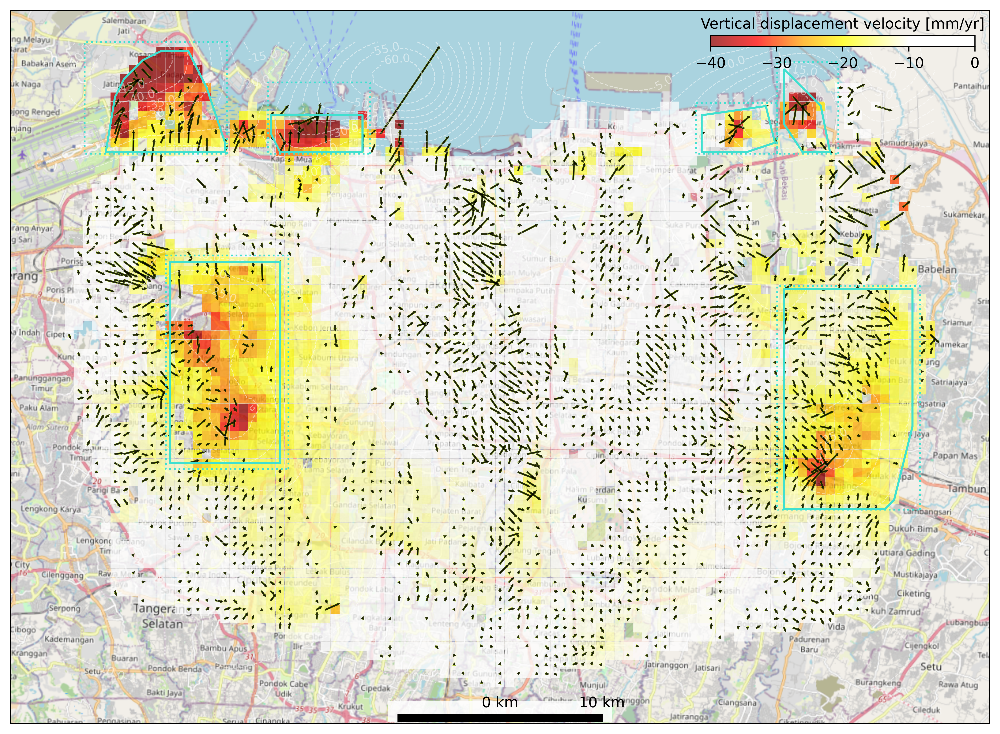

In [23]:
# --- Jakarta GNSS Displacement Plot with EPSG:23830, styled like second example ---

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Ellipse, Rectangle
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import contextily as cx
from shapely.geometry import MultiPoint, Polygon, box
from pykrige.ok import OrdinaryKriging
import matplotlib.ticker as mticker
from matplotlib.colors import LinearSegmentedColormap

# --- Function to create reusable custom colormap ---
def create_hot_not_black_r_cmap():
    """
    Creates a custom colormap:
    dark red → red → orange → yellow → white
    """
    colors = [
        (0.0, "darkred"),   # 0%
        (0.175, "red"),     # 17.5%
        (0.35, "orange"),   # 35%
        (0.50, "yellow"),   # 50%
        (0.75, "white"),    # 75%
        (1.0, "white")      # 100%
    ]
    return LinearSegmentedColormap.from_list("hot_not_black_r", colors)

# --- Formatter for km labels ---
def meters_to_km_labels(x, pos):
    return f"{int(x // 1000)}"
formatter = mticker.FuncFormatter(meters_to_km_labels)

# --- Load Jakarta ENU data ---
data_path = 'jakarta_enu_estimates.pkl'
df = pd.read_pickle(data_path)

x_rum = df['x_rum'].values
y_rum = df['y_rum'].values
east_est = df['east'].values
north_est = df['north'].values
up_est = df['up'].values
var_east = df['var_east'].values
var_north = df['var_north'].values
covar_en = df['covar_en'].values

# --- Settings ---
scaling = 320                 # mm/yr → plot units
plot_streetmap = True
n_std_plot = 2                # Error ellipse multiplier

# --- Create custom colormap ---
custom_cmap = create_hot_not_black_r_cmap()

# --- Kriging for contour map ---
grid_spacing = 500
xCoords = np.arange(np.min(x_rum), np.max(x_rum) + grid_spacing, grid_spacing)
yCoords = np.arange(np.min(y_rum), np.max(y_rum) + grid_spacing, grid_spacing)
X, Y = np.meshgrid(xCoords, yCoords)

OK_up = OrdinaryKriging(
    x_rum, y_rum, up_est,
    variogram_model='gaussian',
    variogram_parameters=[42, 7500, 6],
    verbose=False,
    enable_plotting=False
)
interp_contour_up, _ = OK_up.execute('grid', xCoords, yCoords)

# --- Figure setup ---
x_range = np.max(x_rum) - np.min(x_rum)
y_range = np.max(y_rum) - np.min(y_rum)
aspect_ratio = x_range / y_range
fig_width = 12
fig_height = fig_width / aspect_ratio
fig, ax = plt.subplots(figsize=(fig_width, fig_height), dpi=500)

# --- Scatter plot of vertical displacement ---
vmin, vmax = -40, 0
sc = ax.scatter(
    x_rum, y_rum,
    c=up_est,
    s=37.7,
    alpha=0.75,
    cmap=custom_cmap,  # use the reusable colormap directly
    vmin=vmin, vmax=vmax,
    marker='s', linewidths=0
)

# --- Plot significant positive vectors & ellipses ---
head_len = 0.3 * np.mean(np.abs(east_est) * scaling)
head_wid = head_len
wdt = 0.1 * np.mean(np.abs(east_est) * scaling)

for k in range(len(x_rum)):
    dx = east_est[k] * scaling
    dy = north_est[k] * scaling

    if dx <= 0:
        continue

    x_coord = x_rum[k]
    y_coord = y_rum[k]

    ax.arrow(x_coord, y_coord, dx, dy,
             length_includes_head=True, color='#CCFF00', alpha=0.65,
             width=wdt*2.1, head_length=head_len*1.3, head_width=head_wid*1.3, zorder=1)
    ax.arrow(x_coord, y_coord, dx, dy,
             length_includes_head=True, color='black', alpha=0.8,
             width=wdt, head_length=head_len, head_width=head_wid, zorder=2)

    # Error ellipse
    Q_en = np.array([
        [var_east[k]*scaling, covar_en[k]*scaling],
        [covar_en[k]*scaling, var_north[k]*scaling]
    ])
    eigenvals, eigenvecs = np.linalg.eigh(Q_en)
    order = eigenvals.argsort()[::-1]
    eigenvals, eigenvecs = eigenvals[order], eigenvecs[:, order]
    angle = np.degrees(np.arctan2(*eigenvecs[:,0][::-1]))
    width, height = n_std_plot * np.sqrt(eigenvals)
    ellip = Ellipse(
        (x_coord + dx, y_coord + dy),
        width=width, height=height, angle=angle,
        ec='#CCFF00', alpha=0.65, fc='none', linewidth=0.55
    )
    ax.add_patch(ellip)

# --- Contours ---
contour_levels = np.arange(np.floor(np.min(interp_contour_up)/5)*5,
                           np.ceil(np.max(interp_contour_up)/5)*5 + 5, 5)
contour = ax.contour(X, Y, interp_contour_up, levels=contour_levels,
                     colors='white', linestyles='dashed', alpha=0.5, linewidths=0.65)
ax.clabel(contour, inline=True, fontsize=8, fmt="%.1f", colors='white')

# --- Axis formatting ---
ax.set_xlim(np.min(x_rum) - 2000, np.max(x_rum) + 2000)
ax.set_ylim(np.min(y_rum) - 2000, np.max(y_rum) + 2000)
ax.set_aspect('equal', adjustable='datalim')
ax.set_xticks([])
ax.set_yticks([])
ax.set_xlabel('')
ax.set_ylabel('')

# --- Basemap ---
if plot_streetmap:
    cx.add_basemap(ax, crs='epsg:23830', source=cx.providers.OpenStreetMap.Mapnik, zoom=12, attribution=False)

# --- Subsidence bowls and rectangles ---
regions_proj = [
    (1557000, 807500, 1564000, 813000),
    (1561000, 792000, 1567000, 802500),
    (1566000, 807500, 1571000, 811000),
    (1587000, 807500, 1591000, 810000),
    (1591000, 807500, 1594000, 812000),
    (1591000, 790000, 1598000, 801000)
]
turquoise = "#40E0D0"
xr, yr = np.asarray(x_rum), np.asarray(y_rum)

for (x1, y1, x2, y2) in regions_proj:
    xmin, xmax = min(x1, x2), max(x1, x2)
    ymin, ymax = min(y1, y2), max(y1, y2)
    inside = (xr >= xmin) & (xr <= xmax) & (yr >= ymin) & (yr <= ymax)
    idx = np.nonzero(inside)[0]

    if idx.size >= 3:
        hull = MultiPoint([(xr[j], yr[j]) for j in idx]).convex_hull
        if isinstance(hull, Polygon):
            hx, hy = hull.exterior.xy
            ax.plot(hx, hy, linestyle='-', linewidth=1.4, color=turquoise, zorder=10)
    elif idx.size == 2:
        ax.plot([xr[idx[0]], xr[idx[1]]], [yr[idx[0]], yr[idx[1]]],
                linestyle='-', linewidth=1.0, color=turquoise, zorder=10)
    elif idx.size == 1:
        ax.plot(xr[idx[0]], yr[idx[0]], marker='o', markersize=6, color=turquoise, zorder=11)

    rect = box(xmin, ymin, xmax, ymax)
    rx, ry = rect.exterior.xy
    ax.plot(rx, ry, linestyle=':', linewidth=1.2, color=turquoise, zorder=9)

# --- Scale bar ---
scalebar_length_m = 10000
x_center = 0.5 * (ax.get_xlim()[0] + ax.get_xlim()[1])
y_min = ax.get_ylim()[0]
bar_height = (ax.get_ylim()[1] - ax.get_ylim()[0]) * 0.01

ax.add_patch(Rectangle((x_center-scalebar_length_m/2 - 500, y_min + 50),
                       scalebar_length_m + 1000, bar_height*3,
                       facecolor='white', edgecolor='none', alpha=0.85, zorder=3))
ax.add_patch(Rectangle((x_center-scalebar_length_m/2, y_min+100),
                       scalebar_length_m, bar_height,
                       facecolor='black', edgecolor='black', zorder=4))
ax.text(x_center, y_min+300+bar_height, '0 km', fontsize=10, ha='center', va='bottom', zorder=5)
ax.text(x_center + scalebar_length_m/2, y_min+300+bar_height, '10 km', fontsize=10, ha='center', va='bottom', zorder=5)

# --- Colorbar ---
cax = inset_axes(ax, width="27%", height="1.5%", loc='upper right',
                 bbox_to_anchor=(0, -0.015, 1, 1), bbox_transform=ax.transAxes, borderpad=1)
cbar = plt.colorbar(sc, cax=cax, orientation='horizontal')
cbar.ax.xaxis.set_label_position('top')
cbar.set_label('Vertical displacement velocity [mm/yr]', labelpad=5)

plt.show()


In [ ]:
# --- Jakarta GNSS Displacement Plot (only significant 2σ vectors + subsidence outlines) ---
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Ellipse, Rectangle
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import contextily as cx
from shapely.geometry import MultiPoint, box
from pykrige.ok import OrdinaryKriging
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.ticker as mticker

# --- Custom colormap ---
def create_hot_not_black_r_cmap():
    colors = [
        (0.0, "darkred"),
        (0.175, "red"),
        (0.35, "orange"),
        (0.50, "yellow"),
        (0.75, "white"),
        (1.0, "white")
    ]
    return LinearSegmentedColormap.from_list("hot_not_black_r", colors)

# --- Formatter for km labels ---
def meters_to_km_labels(x, pos):
    return f"{int(x // 1000)}"
formatter = mticker.FuncFormatter(meters_to_km_labels)

# --- Load Jakarta ENU data ---
data_path = 'jakarta_enu_estimates.pkl'
df = pd.read_pickle(data_path)

x_rum = df['x_rum'].values
y_rum = df['y_rum'].values
east_est = df['east'].values
north_est = df['north'].values
up_est = df['up'].values
var_east = df['var_east'].values
var_north = df['var_north'].values
covar_en = df['covar_en'].values

# --- Settings ---
scaling = 320  # mm/yr → plot units
n_std_plot = 2
plot_streetmap = True
nr_vectors_plot = len(x_rum)
random_idx = np.arange(nr_vectors_plot)

# --- Kriging for vertical displacement contour ---
grid_spacing = 500
xCoords = np.arange(np.min(x_rum), np.max(x_rum)+grid_spacing, grid_spacing)
yCoords = np.arange(np.min(y_rum), np.max(y_rum)+grid_spacing, grid_spacing)
X, Y = np.meshgrid(xCoords, yCoords)

OK_up = OrdinaryKriging(
    x_rum, y_rum, up_est,
    variogram_model='gaussian',
    variogram_parameters=[42, 7500, 6],
    verbose=False,
    enable_plotting=False
)
interp_contour_up, _ = OK_up.execute('grid', xCoords, yCoords)

# --- Figure setup ---
x_range = np.max(x_rum) - np.min(x_rum)
y_range = np.max(y_rum) - np.min(y_rum)
fig_width = 12
fig_height = fig_width / (x_range / y_range)
fig, ax = plt.subplots(figsize=(fig_width, fig_height), dpi=500)

# --- Vertical displacement scatter ---
vmin, vmax = -40, 0
custom_cmap = create_hot_not_black_r_cmap()
sc = ax.scatter(
    x_rum, y_rum,
    c=up_est,
    s=37.7,
    alpha=0.75,
    cmap=custom_cmap,
    vmin=vmin, vmax=vmax,
    marker='s', linewidths=0
)

# --- Vector & ellipse scaling ---
transversal_mm_all = np.sqrt(east_est**2 + north_est**2) * scaling
head_len = 0.3 * np.mean(transversal_mm_all)
head_wid = head_len
wdt = 0.1 * np.mean(transversal_mm_all)

plotted_vectors = []
skipped_vectors = []

for k in range(nr_vectors_plot):
    x_coord_rum = x_rum[random_idx[k]]
    y_coord_rum = y_rum[random_idx[k]]
    east_rum = east_est[random_idx[k]] * scaling
    north_rum = north_est[random_idx[k]] * scaling

    Q_en = np.array([
        [var_east[random_idx[k]] * scaling**2, covar_en[random_idx[k]] * scaling**2],
        [covar_en[random_idx[k]] * scaling**2, var_north[random_idx[k]] * scaling**2]
    ])

    trans_displ_rum = np.sqrt(east_rum**2 + north_rum**2)

    # Skip non-significant vectors (2σ)
    eigenvals, _ = np.linalg.eigh(Q_en)
    width, height = n_std_plot * np.sqrt(eigenvals)
    if trans_displ_rum <= max(width/2, height/2):
        skipped_vectors.append(trans_displ_rum)
        continue

    plotted_vectors.append(trans_displ_rum)

    # --- Double-stroke arrow ---
    ax.arrow(
        x_coord_rum, y_coord_rum, east_rum, north_rum,
        length_includes_head=True, color='#CCFF00', alpha=0.8,
        width=wdt*2.1, head_length=head_len*1.3, head_width=head_wid*1.3, zorder=1
    )
    ax.arrow(
        x_coord_rum, y_coord_rum, east_rum, north_rum,
        length_includes_head=True, color='black', alpha=0.8,
        width=wdt, head_length=head_len, head_width=head_wid, zorder=2
    )

    # --- Ellipse at tip ---
    eigenvals, eigenvecs = np.linalg.eigh(Q_en)
    order = eigenvals.argsort()[::-1]
    eigenvals, eigenvecs = eigenvals[order], eigenvecs[:, order]
    angle = np.degrees(np.arctan2(*eigenvecs[:,0][::-1]))
    width, height = n_std_plot * np.sqrt(eigenvals)
    ellip = Ellipse(
        (x_coord_rum + east_rum, y_coord_rum + north_rum),
        width=width, height=height,
        angle=angle, ec='#CCFF00', fc='none', alpha=0.65, linewidth=0.55
    )
    ax.add_patch(ellip)

# --- Print vector statistics ---
print(f"No. representative (>2sigma) transversal vectors ({len(plotted_vectors)})}, "
      f"std={np.std(plotted_vectors):.2f}, min={np.min(plotted_vectors):.2f})
print(f"No. of skipped trasnversal vectors ({len(skipped_vectors)}), "
      f"std={np.std(skipped_vectors):.2f}, min={np.min(skipped_vectors):.2f}, max={np.max(skipped_vectors):.2f}")

# --- Contours ---
contour_levels = np.arange(np.floor(np.min(interp_contour_up)/5)*5,
                           np.ceil(np.max(interp_contour_up)/5)*5 + 5, 5)
contour = ax.contour(
    X, Y, interp_contour_up,
    levels=contour_levels,
    colors='white', linestyles='dashed',
    alpha=0.5, linewidths=0.65
)
ax.clabel(contour, inline=True, fontsize=8, fmt="%.1f", colors='white')

# --- Subsurface bowls outlines ---
subsidence_regions = [
    (1557000, 807500, 1564000, 813000),
    (1561000, 792000, 1567000, 802500),
    (1566000, 807500, 1571000, 811000),
    (1587000, 807500, 1591000, 810000),
    (1591000, 807500, 1594000, 812000),
    (1591000, 790000, 1598000, 801000)
]
roman_labels = ["I", "II", "III", "IV", "V", "VI"]
turquoise = "#40E0D0"

for i, (x1, y1, x2, y2) in enumerate(subsidence_regions):
    xmin, xmax = min(x1, x2), max(x1, x2)
    ymin, ymax = min(y1, y2), max(y1, y2)
    inside = (x_rum >= xmin) & (x_rum <= xmax) & (y_rum >= ymin) & (y_rum <= ymax)
    idx = np.nonzero(inside)[0]

    if idx.size >= 3:
        pts = [(x_rum[j], y_rum[j]) for j in idx]
        hull = MultiPoint(pts).convex_hull
        hx, hy = hull.exterior.xy
        ax.plot(hx, hy, linestyle='-', linewidth=1.4, color=turquoise, zorder=10)

    rect = box(xmin, ymin, xmax, ymax)
    rx, ry = rect.exterior.xy
    ax.plot(rx, ry, linestyle=':', linewidth=1.2, color=turquoise, zorder=9)

    if i == 4:
        ax.text(xmax, ymin, roman_labels[i], color=turquoise, fontsize=12,
                fontweight='bold', ha='right', va='top', zorder=12)
    else:
        ax.text(xmin, ymax, roman_labels[i], color=turquoise, fontsize=12,
                fontweight='bold', ha='left', va='bottom', zorder=12)

# --- Axis limits and basemap ---
ax.set_xlim(np.min(x_rum)-2000, np.max(x_rum)+2000)
ax.set_ylim(np.min(y_rum)-2000, np.max(y_rum)+2000)
ax.set_aspect('equal', adjustable='datalim')
ax.set_xticks([])
ax.set_yticks([])
if plot_streetmap:
    cx.add_basemap(ax, crs='epsg:23830', source=cx.providers.OpenStreetMap.Mapnik, zoom=12, attribution=False)

# --- Colorbar ---
cax = inset_axes(ax, width="27%", height="1.5%", loc='upper right',
                 bbox_to_anchor=(0, -0.015, 1, 1), bbox_transform=ax.transAxes, borderpad=1)
cbar = plt.colorbar(sc, cax=cax, orientation='horizontal')
cbar.ax.xaxis.set_label_position('top')
cbar.set_label('Vertical displacement velocity [mm/yr]', labelpad=5)

plt.show()


Plotted vectors (1949): mean=409.38, std=307.20, min=18.04, max=5396.14
Skipped vectors (2830): mean=112.71, std=73.91, min=0.04, max=575.56


In [8]:
# --- Compute transversal displacement ---
trans_displ_rum = np.sqrt(east_est**2 + north_est**2)

# --- Define subsidence regions as polygons for masking ---
from shapely.geometry import Polygon, Point

subsidence_polygons = []
for x1, y1, x2, y2 in subsidence_regions:
    poly = Polygon([
        (x1, y1),
        (x1, y2),
        (x2, y2),
        (x2, y1)
    ])
    subsidence_polygons.append(poly)

# --- Mask points outside all subsidence regions ---
outside_mask = np.ones(len(x_rum), dtype=bool)
for poly in subsidence_polygons:
    for i in range(len(x_rum)):
        if poly.contains(Point(x_rum[i], y_rum[i])):
            outside_mask[i] = False

# --- Compute statistics function ---
def print_stats(label, values, mask=None):
    if mask is not None:
        values = values[mask]
    mean_val = np.mean(values)
    std_val = np.std(values)
    print(f"{label}: mean = {mean_val:.2f}, std = {std_val:.2f}")

# --- Print statistics ---
print("\n--- Velocity statistics (all points) ---")
print_stats("East [mm/yr]", east_est)
print_stats("North [mm/yr]", north_est)
print_stats("Up [mm/yr]", up_est)
print_stats("Transversal [mm/yr]", trans_displ_rum)

print("\n--- Velocity statistics (outside 6 subsidence regions) ---")
print_stats("East [mm/yr]", east_est, mask=outside_mask)
print_stats("North [mm/yr]", north_est, mask=outside_mask)
print_stats("Up [mm/yr]", up_est, mask=outside_mask)
print_stats("Transversal [mm/yr]", trans_displ_rum, mask=outside_mask)



--- Velocity statistics (all points) ---
East [mm/yr]: mean = -0.02, std = 0.73
North [mm/yr]: mean = 0.03, std = 0.78
Up [mm/yr]: mean = -11.22, std = 7.26
Transversal [mm/yr]: mean = 0.73, std = 0.78

--- Velocity statistics (outside 6 subsidence regions) ---
East [mm/yr]: mean = 0.01, std = 0.66
North [mm/yr]: mean = -0.00, std = 0.62
Up [mm/yr]: mean = -9.06, std = 4.53
Transversal [mm/yr]: mean = 0.64, std = 0.65
